In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [2]:
import pandas as pd
df = pd.read_csv("/content/drive/My Drive/dataset/IRIS.csv")
df.head(5)

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,Iris-setosa
1,4.9,3.0,1.4,0.2,Iris-setosa
2,4.7,3.2,1.3,0.2,Iris-setosa
3,4.6,3.1,1.5,0.2,Iris-setosa
4,5.0,3.6,1.4,0.2,Iris-setosa


/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm
/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:243: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


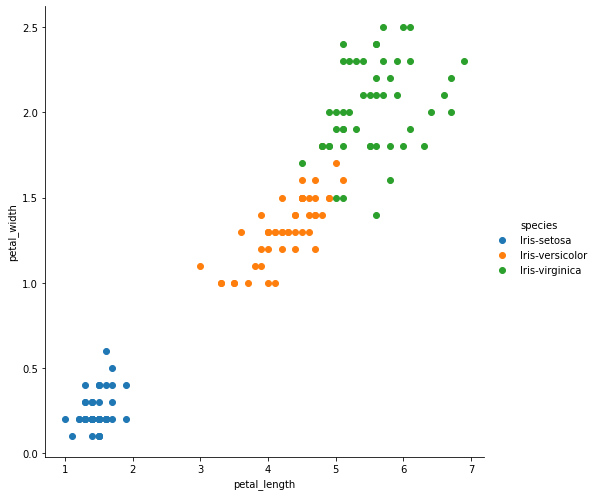

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.FacetGrid(df, hue="species", size=7) \
   .map(plt.scatter, "petal_length", "petal_width") \
   .add_legend()

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:2071: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


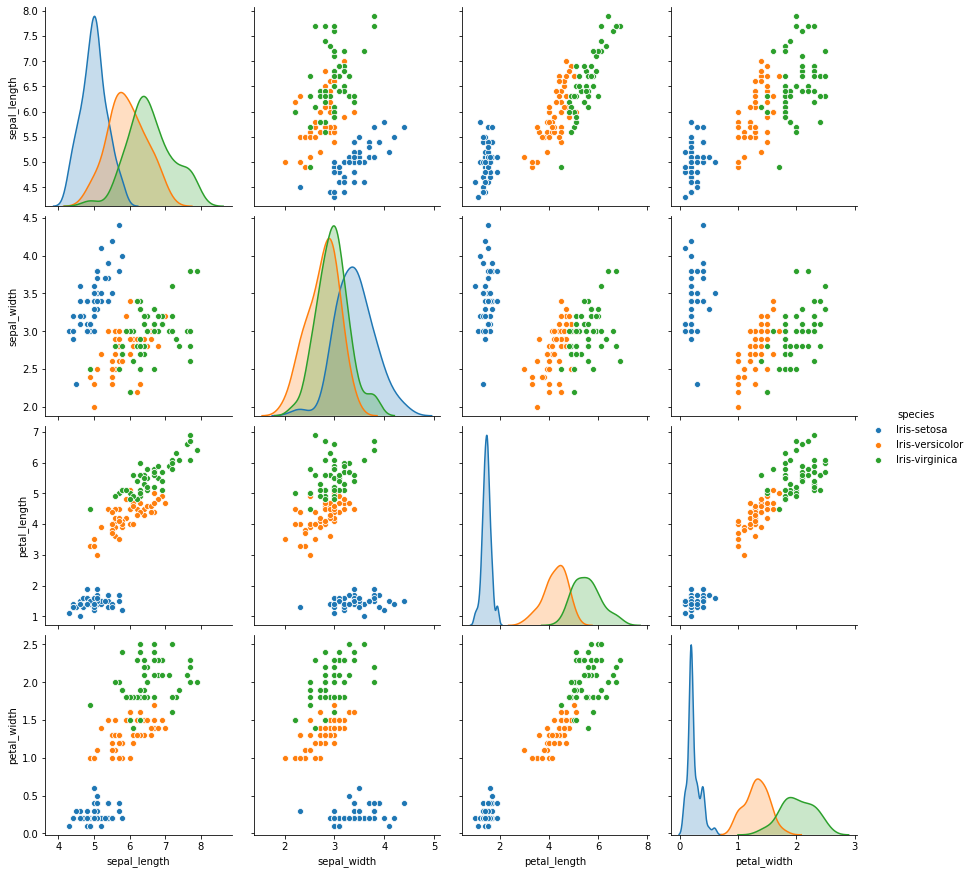

In [4]:
sns.pairplot(df,hue="species",size=3);
plt.show()

In [5]:
y =  df.pop('species') #pisahkan antara data dan label

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df, y, test_size=0.33, random_state=42)
X_train

,sepal_length,sepal_width,petal_length,petal_width
96,5.7,2.9,4.2,1.3
105,7.6,3.0,6.6,2.1
66,5.6,3.0,4.5,1.5
0,5.1,3.5,1.4,0.2
122,7.7,2.8,6.7,2.0
...,...,...,...,...
71,6.1,2.8,4.0,1.3
106,4.9,2.5,4.5,1.7
14,5.8,4.0,1.2,0.2
92,5.8,2.6,4.0,1.2


In [6]:
from sklearn.tree import DecisionTreeClassifier
model = DecisionTreeClassifier()
model.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [0]:
hasil = model.predict(X_test)

In [8]:
from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, hasil)

array([[19,  0,  0],
       [ 0, 15,  0],
       [ 0,  1, 15]])

In [0]:
#MAPS USING FOLIUM
import pandas as pd
df2 = pd.read_csv("/content/drive/My Drive/dataset/statelatlong.csv")
df2.head(5)

,State,Latitude,Longitude,City
0,AL,32.601011,-86.680736,Alabama
1,AK,61.302501,-158.775020,Alaska
2,AZ,34.168219,-111.930907,Arizona
3,AR,34.751928,-92.131378,Arkansas
4,CA,37.271875,-119.270415,California


In [0]:
import folium as fol
m = fol.Map(location=[-6.3705633,106.8296376],
                    zoom_start = 17)
mark = fol.Marker([-6.3705633,106.8296376], popup='UI')
mark.add_to(m)
m

In [0]:
import folium as fol
m = fol.Map(location=[36.2108363,-113.7208401],
                    zoom_start = 2)
for index,row in df2.iterrows():
  mark = fol.Marker([row['Latitude'],
                     row['Longitude']], 
                    popup=row['City'])
  mark.add_to(m)
m
#Latitude	Longitude	City

In [0]:
import folium as fol
m = fol.Map(location=[36.2108363,-113.7208401],zoom_start = 2)
for index,row in df2.iterrows():
  mark = fol.Marker([row['Latitude'],row['lon']],popup=row['country'])
  mark.add_to(m)
m

In [0]:
import pandas as pd

df3 = pd.read_csv("/content/drive/My Drive/dataset/news.csv")
df3.tail(1)

,Unnamed: 0,authors,title,publish_date,description,text,url
6787,6786,[],N.S. municipality warns against annual Easter ...,2020-04-06 9:00,"In the midst of a pandemic, a Nova Scotia muni...","In the midst of a pandemic, a Nova Scotia muni...",https://www.cbc.ca/news/canada/nova-scotia/cla...


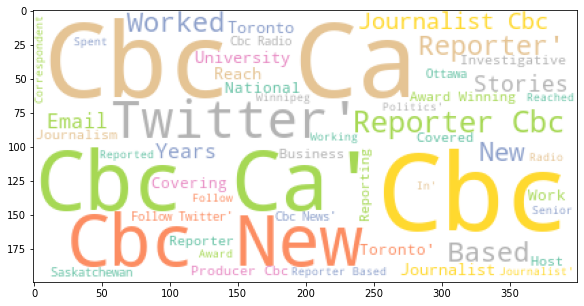

In [0]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud, ImageColorGenerator

text = " ".join(str(author) for author in df3.authors.unique() if len(author)>3)
wordcloud = WordCloud(max_words=50,colormap='Set2', background_color="white").generate(text)
plt.figure(figsize=(10,5))
plt.imshow(wordcloud)
plt.show()